### Imports

In [1]:
import pandas as pd
import numpy as np
import geopandas as gpd

In [2]:
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline 
mpl.rcParams['figure.dpi'] = 300

In [3]:
from sklearn.preprocessing import Normalizer

In [4]:
from chart_studio import plotly
import plotly.figure_factory as ff

In [5]:
pd.options.display.max_rows = 4000
pd.options.display.max_columns = 4000

In [6]:
gov_arch_csv = '../data/v2/communities_data_prepped.csv'

In [7]:
gov_df = pd.read_csv(gov_arch_csv)

In [8]:
gov_df.head()

,Name,Institutions,Mechanism,Culture/Values/Norms,Notes,Time span,Time span: Start,Time span: End,Geography,Size,Source,Metanotes,Heterogeneity,FC comments,expert check,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_kingchief-as-figurehead,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_mediation,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_checks_and_balances,enforcement_mechanisms_include_judicial_review,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_assembly_central,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_autocratic_leader_unbound,access_mechanisms_include_life_appointment,access_mechanisms_include_heredity,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_quorum,access_mechanisms_include_popularity_,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_balance_of_power,access_mechanisms_include_divine_right,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_co-optation,decision_making_mechanisms_include_constitution,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_turnover_rotation,access_mechanisms_include_female_participation,decision_making_mechanisms_include_consultation,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_police,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,enforcement_mechanisms_include_reputational_risk,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_screening_process,access_mechanisms_include_gerontocracy,access_mechanisms_include_payment_for_occupying_office,decision_making_mechanisms_include_board_committee,access_mechanisms_include_property_requirement,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_enfranchisement,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_assembly_local,access_mecha

In [9]:
# Drop Region: Europe

In [10]:
gov_df['Region: Europe'].sum()

23

In [11]:
gov_df = gov_df[gov_df['Region: Europe'] != 1]

In [12]:
gov_df['Region: Europe'].sum()

0

# Normalized Correlation Matrix

In [13]:
data_plot = gov_df.select_dtypes(include=[np.number]).dropna()

In [14]:
data_plot.describe()

,Time span: Start,Time span: End,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_kingchief-as-figurehead,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_mediation,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_checks_and_balances,enforcement_mechanisms_include_judicial_review,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_assembly_central,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_autocratic_leader_unbound,access_mechanisms_include_life_appointment,access_mechanisms_include_heredity,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_quorum,access_mechanisms_include_popularity_,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_balance_of_power,access_mechanisms_include_divine_right,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_co-optation,decision_making_mechanisms_include_constitution,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_turnover_rotation,access_mechanisms_include_female_participation,decision_making_mechanisms_include_consultation,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_police,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,enforcement_mechanisms_include_reputational_risk,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_screening_process,access_mechanisms_include_gerontocracy,access_mechanisms_include_payment_for_occupying_office,decision_making_mechanisms_include_board_committee,access_mechanisms_include_property_requirement,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_enfranchisement,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_temporary_position_

In [ ]:
normalized = Normalizer().fit_transform(data_plot)

norm_df = pd.DataFrame(normalized)
norm_df.columns = data_plot.columns
norm_corr = norm_df.corr()

norm_corr

## Sort all correlations 

In [16]:
def get_redundant_pairs(df):
    '''Get diagonal and lower triangular pairs of correlation matrix'''
    pairs_to_drop = set()
    cols = df.columns
    for i in range(0, df.shape[1]):
        for j in range(0, i+1):
            pairs_to_drop.add((cols[i], cols[j]))
    return pairs_to_drop

In [17]:
def get_sorted_correlations(corr_df, n=100, ascending=False):
    au_corr = corr_df.unstack()
    labels_to_drop = get_redundant_pairs(corr_df)
    au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=ascending)
    return au_corr

In [18]:
# Highest 200 positively correlated variables
print(get_sorted_correlations(norm_corr, n=200, ascending=False))

enforcement_mechanisms_include_graduated_sanctions  Size: 100 - 1,000                                 1.0
Geography: Oceania                                  Region: Oceania                                   1.0
decision_making_mechanisms_include_petition         decision_making_mechanisms_include_bureaucracy    1.0
                                                    Geography: Africa North                           1.0
enforcement_mechanisms_include_forced_labour        Geography: Africa North                           1.0
                                                                                                     ... 
Region: Europe                                      Region: North America                             NaN
                                                    Region: Central America                           NaN
                                                    Region: South America                             NaN
                                              

In [19]:
get_sorted_correlations(norm_corr, n=200, ascending=False).to_csv('../csv/mechanisms_all_correlations_no_europe.csv')

In [20]:
# Highest 200 negatively correlated variables 
print(get_sorted_correlations(norm_corr, n=200, ascending=True))

Time span: Start  Time span: Duration                                   -0.650546
Time span: End    enforcement_mechanisms_include_jury_judge             -0.542599
Time span: Start  decision_making_mechanisms_include_assembly_central   -0.537902
Time span: End    decision_making_mechanisms_include_assembly_central   -0.479448
Time span: Start  Geography: Asia, India (northeast)                    -0.470441
                                                                           ...   
Region: Europe    Region: North America                                       NaN
                  Region: Central America                                     NaN
                  Region: South America                                       NaN
                  Region: Oceania                                             NaN
                  Time span: Duration                                         NaN
Length: 12090, dtype: float64


In [21]:
get_sorted_correlations(norm_corr, n=200, ascending=True).to_csv('../csv/mechanisms_negative_correlations.csv')

# Mechanisms

In [22]:
mechanisms_list = [x for x in gov_df.columns if 'mechanisms_' in x]
mechanisms_list.sort()
mechanisms_list

['access_mechanisms_include_age_boundaries',
 'access_mechanisms_include_blood_relations',
 'access_mechanisms_include_co-optation',
 'access_mechanisms_include_divine_right',
 'access_mechanisms_include_dreaming',
 'access_mechanisms_include_election',
 'access_mechanisms_include_enfranchisement',
 'access_mechanisms_include_female_participation',
 'access_mechanisms_include_gerontocracy',
 'access_mechanisms_include_heredity',
 'access_mechanisms_include_induction_rite_ceremony',
 'access_mechanisms_include_life_appointment',
 'access_mechanisms_include_lottery_random_selection',
 'access_mechanisms_include_matriarchy',
 'access_mechanisms_include_matrilineality',
 'access_mechanisms_include_meritocracy',
 'access_mechanisms_include_open_political_unit',
 'access_mechanisms_include_patronage_for_office',
 'access_mechanisms_include_payment_for_occupying_office',
 'access_mechanisms_include_popularity_',
 'access_mechanisms_include_property_requirement',
 'access_mechanisms_include_sc

In [23]:
access_mechanisms = [x for x in gov_df.columns if 'access_mechanisms_' in x]

In [24]:
decision_making_mechanisms = [x for x in gov_df.columns if 'decision_making_mechanisms_' in x]

In [25]:
enforcement_mechanisms = [x for x in gov_df.columns if 'enforcement_mechanisms_' in x]

In [26]:
# mechanisms_df = gov_df[['Name'] + mechanisms_list]
mechanisms_df = gov_df[mechanisms_list]

In [27]:
mechanisms_df

,access_mechanisms_include_age_boundaries,access_mechanisms_include_blood_relations,access_mechanisms_include_co-optation,access_mechanisms_include_divine_right,access_mechanisms_include_dreaming,access_mechanisms_include_election,access_mechanisms_include_enfranchisement,access_mechanisms_include_female_participation,access_mechanisms_include_gerontocracy,access_mechanisms_include_heredity,access_mechanisms_include_induction_rite_ceremony,access_mechanisms_include_life_appointment,access_mechanisms_include_lottery_random_selection,access_mechanisms_include_matriarchy,access_mechanisms_include_matrilineality,access_mechanisms_include_meritocracy,access_mechanisms_include_open_political_unit,access_mechanisms_include_patronage_for_office,access_mechanisms_include_payment_for_occupying_office,access_mechanisms_include_popularity_,access_mechanisms_include_property_requirement,access_mechanisms_include_screening_process,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_balance_of_power,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_plurality_voting,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_word_of_mouth,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_capital_punishment,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanisms_include_exit,enfor

In [33]:
plt.figure(figsize=(40,40))
sns.heatmap(mechanisms_df.corr(),
            cmap='BrBG')

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations-no-europe/mechanisms_correlations.png')
plt.show()

### Look at correlations for specific variables

In [ ]:
norm_corr['Time span: Duration'].sort_values(ascending=False)

In [ ]:
norm_corr['Time span: Duration'].sort_values(ascending=True)

Time span: Start                                                                  -0.650546
Time span: End                                                                    -0.387067
Size: 1,001 - 10,000                                                              -0.320560
Region: North America                                                             -0.253590
enforcement_mechanisms_include_criticism_mocking_joking                           -0.240693
enforcement_mechanisms_include_self-help                                          -0.239927
Geography: Asia Southeast                                                         -0.221240
enforcement_mechanisms_include_arbitration                                        -0.219398
decision_making_mechanisms_include_council_local                                  -0.212037
enforcement_mechanisms_include_capital_punishment                                 -0.202071
access_mechanisms_include_matrilineality                                        

In [ ]:
norm_corr['Region: Africa'].sort_values(ascending=False)

Region: Africa                                                                     1.000000
Geography: Africa North                                                            0.862642
decision_making_mechanisms_include_temporary_position_of_power_term_limits         0.818194
enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription         0.807699
enforcement_mechanisms_include_tribunal_court_                                     0.804047
Size: 100,001 - 1,000,000                                                          0.719255
access_mechanisms_include_election                                                 0.710138
access_mechanisms_include_blood_relations                                          0.654220
decision_making_mechanisms_include_assembly_central                                0.625056
decision_making_mechanisms_include_council_central_                                0.606250
decision_making_mechanisms_include_magistrate_official                          

In [ ]:
norm_corr[['Region: Africa', 'Region: Oceania']]

,Region: Africa,Region: Oceania
Time span: Start,-0.169085,0.105955
Time span: End,-0.079087,0.077793
enforcement_mechanisms_include_seizing_of_property,-0.056629,-0.023256
decision_making_mechanisms_include_public_meetings,-0.116613,-0.047889
decision_making_mechanisms_include_power_fluidity,-0.056629,-0.023256
decision_making_mechanisms_include_petition,0.083561,-0.023256
decision_making_mechanisms_include_veto,-0.056629,-0.023256
decision_making_mechanisms_include_representation,0.044977,-0.096097
decision_making_mechanisms_include_rule_of_law,NaN,NaN
enforcement_mechanisms_include_appeal,0.004622,-0.032915


In [38]:
norm_corr[['Time span: Duration'] + mechanisms_list].sort_values(by='Time span: Duration', ascending=True)

,Time span: Duration,access_mechanisms_include_age_boundaries,access_mechanisms_include_blood_relations,access_mechanisms_include_co-optation,access_mechanisms_include_divine_right,access_mechanisms_include_dreaming,access_mechanisms_include_election,access_mechanisms_include_enfranchisement,access_mechanisms_include_female_participation,access_mechanisms_include_gerontocracy,access_mechanisms_include_heredity,access_mechanisms_include_induction_rite_ceremony,access_mechanisms_include_life_appointment,access_mechanisms_include_lottery_random_selection,access_mechanisms_include_matriarchy,access_mechanisms_include_matrilineality,access_mechanisms_include_meritocracy,access_mechanisms_include_open_political_unit,access_mechanisms_include_patronage_for_office,access_mechanisms_include_payment_for_occupying_office,access_mechanisms_include_popularity_,access_mechanisms_include_property_requirement,access_mechanisms_include_screening_process,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_balance_of_power,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_plurality_voting,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_word_of_mouth,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_capital_punishment,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanism

In [39]:
norm_corr[['Time span: Duration'] + mechanisms_list].sort_values(by='Time span: Duration', ascending=False)

,Time span: Duration,access_mechanisms_include_age_boundaries,access_mechanisms_include_blood_relations,access_mechanisms_include_co-optation,access_mechanisms_include_divine_right,access_mechanisms_include_dreaming,access_mechanisms_include_election,access_mechanisms_include_enfranchisement,access_mechanisms_include_female_participation,access_mechanisms_include_gerontocracy,access_mechanisms_include_heredity,access_mechanisms_include_induction_rite_ceremony,access_mechanisms_include_life_appointment,access_mechanisms_include_lottery_random_selection,access_mechanisms_include_matriarchy,access_mechanisms_include_matrilineality,access_mechanisms_include_meritocracy,access_mechanisms_include_open_political_unit,access_mechanisms_include_patronage_for_office,access_mechanisms_include_payment_for_occupying_office,access_mechanisms_include_popularity_,access_mechanisms_include_property_requirement,access_mechanisms_include_screening_process,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_balance_of_power,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_plurality_voting,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_word_of_mouth,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_capital_punishment,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanism

In [40]:
norm_corr['Region: Africa'].sort_values(ascending=False)

Region: Africa                                                                     1.000000
Geography: Africa North                                                            0.862642
decision_making_mechanisms_include_temporary_position_of_power_term_limits         0.818194
enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription         0.807699
enforcement_mechanisms_include_tribunal_court_                                     0.804047
Size: 100,001 - 1,000,000                                                          0.719255
access_mechanisms_include_election                                                 0.710138
access_mechanisms_include_blood_relations                                          0.654220
decision_making_mechanisms_include_assembly_central                                0.625056
decision_making_mechanisms_include_council_central_                                0.606250
decision_making_mechanisms_include_magistrate_official                          

In [41]:
norm_corr['decision_making_mechanisms_include_assembly_central'].sort_values(ascending=False)

decision_making_mechanisms_include_assembly_central                                1.000000
decision_making_mechanisms_include_magistrate_official                             0.773073
Geography: Africa North                                                            0.725097
decision_making_mechanisms_include_temporary_position_of_power_term_limits         0.711345
enforcement_mechanisms_include_tribunal_court_                                     0.660322
access_mechanisms_include_blood_relations                                          0.637341
enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription         0.636938
Region: Africa                                                                     0.625056
access_mechanisms_include_election                                                 0.593190
Size: 100,001 - 1,000,000                                                          0.578922
decision_making_mechanisms_include_council_central_                             

In [42]:
mechanisms_corr_df = norm_corr[mechanisms_list]

In [43]:
mechanisms_corr_df

,access_mechanisms_include_age_boundaries,access_mechanisms_include_blood_relations,access_mechanisms_include_co-optation,access_mechanisms_include_divine_right,access_mechanisms_include_dreaming,access_mechanisms_include_election,access_mechanisms_include_enfranchisement,access_mechanisms_include_female_participation,access_mechanisms_include_gerontocracy,access_mechanisms_include_heredity,access_mechanisms_include_induction_rite_ceremony,access_mechanisms_include_life_appointment,access_mechanisms_include_lottery_random_selection,access_mechanisms_include_matriarchy,access_mechanisms_include_matrilineality,access_mechanisms_include_meritocracy,access_mechanisms_include_open_political_unit,access_mechanisms_include_patronage_for_office,access_mechanisms_include_payment_for_occupying_office,access_mechanisms_include_popularity_,access_mechanisms_include_property_requirement,access_mechanisms_include_screening_process,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_balance_of_power,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_plurality_voting,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_word_of_mouth,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_capital_punishment,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanisms_include_exit,enfor

In [44]:
query_mechanisms_df = mechanisms_corr_df.transpose()

In [45]:
query_mechanisms_df.head()

,Time span: Start,Time span: End,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_kingchief-as-figurehead,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_mediation,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_checks_and_balances,enforcement_mechanisms_include_judicial_review,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_assembly_central,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_autocratic_leader_unbound,access_mechanisms_include_life_appointment,access_mechanisms_include_heredity,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_quorum,access_mechanisms_include_popularity_,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_balance_of_power,access_mechanisms_include_divine_right,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_co-optation,decision_making_mechanisms_include_constitution,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_turnover_rotation,access_mechanisms_include_female_participation,decision_making_mechanisms_include_consultation,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_police,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,enforcement_mechanisms_include_reputational_risk,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_screening_process,access_mechanisms_include_gerontocracy,access_mechanisms_include_payment_for_occupying_office,decision_making_mechanisms_include_board_committee,access_mechanisms_include_property_requirement,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_enfranchisement,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_temporary_position_

## Time x Mechanism

In [46]:
time_span_cols = ['Time span: Start', 'Time span: End', 'Time span: Duration']

In [47]:
time_mechanisms = query_mechanisms_df[time_span_cols]
time_mechanisms

,Time span: Start,Time span: End,Time span: Duration
access_mechanisms_include_age_boundaries,-0.088867,-0.089108,0.046639
access_mechanisms_include_blood_relations,-0.226790,-0.156343,0.295465
access_mechanisms_include_co-optation,NaN,NaN,NaN
access_mechanisms_include_divine_right,-0.221672,-0.274493,-0.013324
access_mechanisms_include_dreaming,0.183339,0.142150,-0.199722
access_mechanisms_include_election,-0.075067,-0.030664,0.150152
access_mechanisms_include_enfranchisement,NaN,NaN,NaN
access_mechanisms_include_female_participation,0.309083,0.311560,-0.158142
access_mechanisms_include_gerontocracy,-0.047281,-0.111838,-0.135160
access_mechanisms_include_heredity,-0.034176,-0.057639,-0.040093


In [49]:
plt.figure(figsize=(40, 30))

sns.heatmap(time_mechanisms.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations-no-eu/time_mechanisms.png')
plt.show()

### Time x Mechanism: Access, Decision Making, Enforcement

In [50]:
time_access_mechanisms = time_mechanisms.loc[access_mechanisms]

In [51]:
time_access_mechanisms

,Time span: Start,Time span: End,Time span: Duration
access_mechanisms_include_matrilineality,0.244255,0.215521,-0.201178
access_mechanisms_include_patronage_for_office,-0.000736,0.006470,0.018286
access_mechanisms_include_age_boundaries,-0.088867,-0.089108,0.046639
access_mechanisms_include_blood_relations,-0.226790,-0.156343,0.295465
access_mechanisms_include_life_appointment,NaN,NaN,NaN
access_mechanisms_include_heredity,-0.034176,-0.057639,-0.040093
access_mechanisms_include_popularity_,0.150205,0.160125,-0.055210
access_mechanisms_include_divine_right,-0.221672,-0.274493,-0.013324
access_mechanisms_include_co-optation,NaN,NaN,NaN
access_mechanisms_include_female_participation,0.309083,0.311560,-0.158142


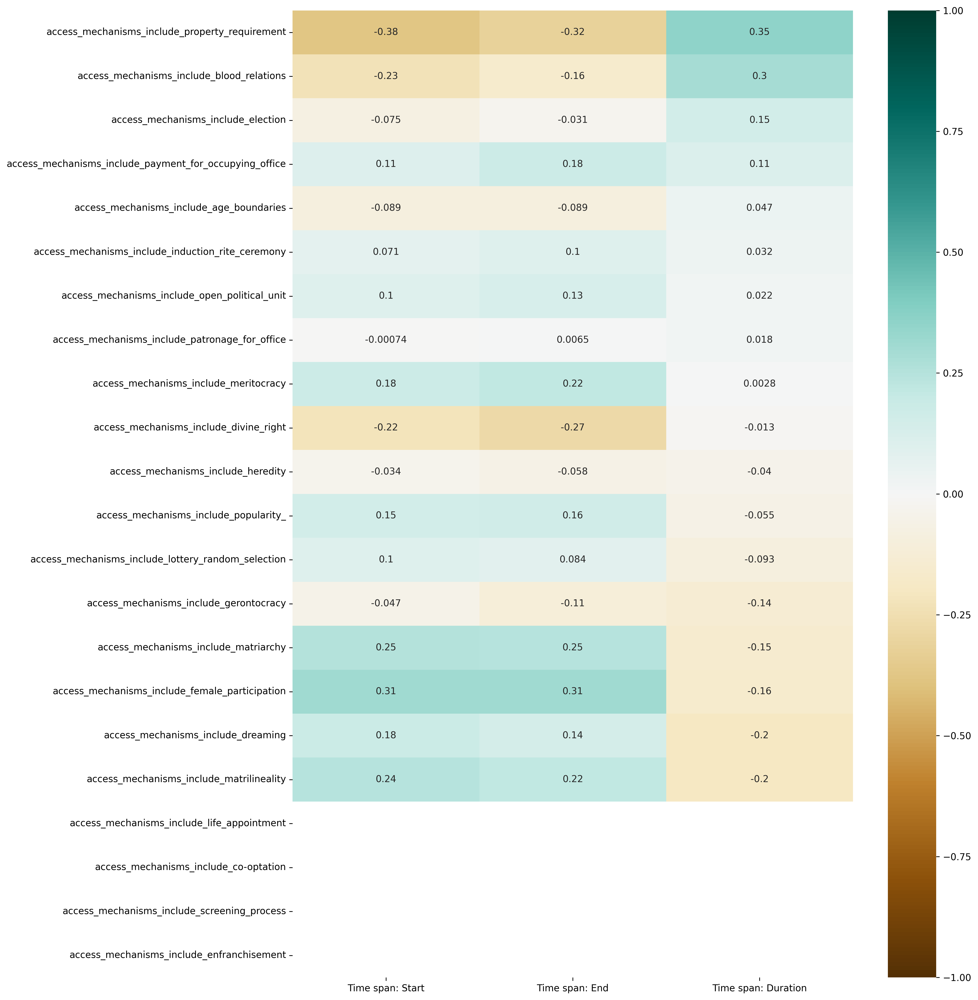

In [52]:
plt.figure(figsize=(15, 15))

sns.heatmap(time_access_mechanisms.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations-no-eu/time_access_mechanisms.png')
plt.show()

In [53]:
time_decision_making_mechanisms = time_mechanisms.loc[decision_making_mechanisms]

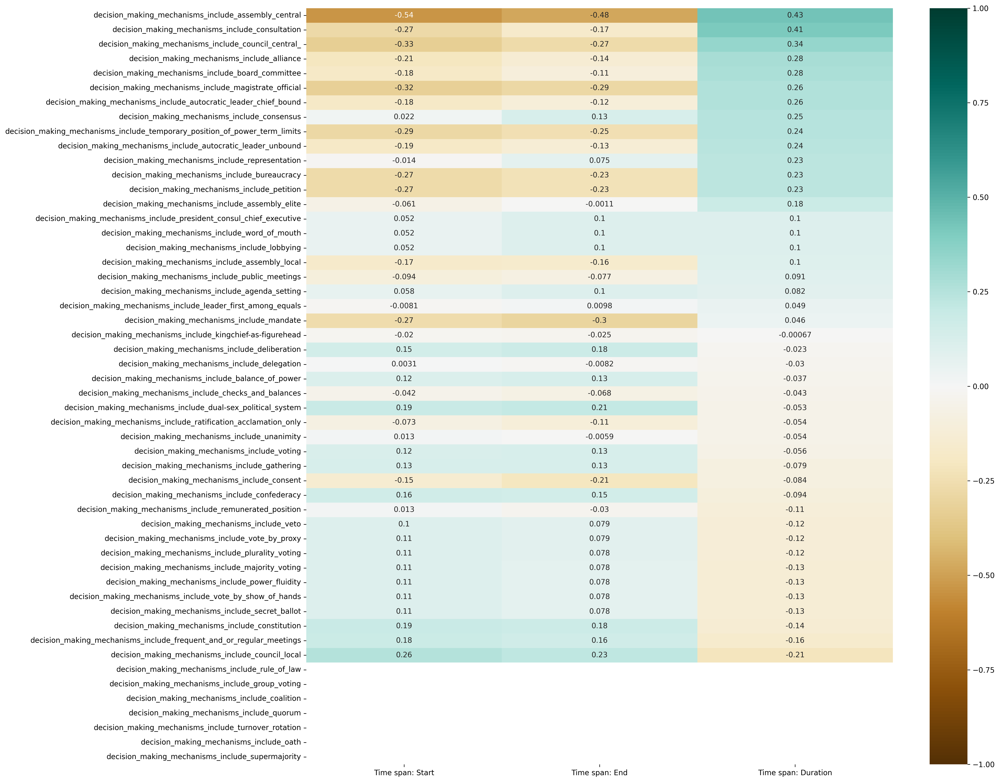

In [54]:
plt.figure(figsize=(20, 15))

sns.heatmap(time_decision_making_mechanisms.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations-no-eu/time_decision_making_mechanisms.png')
plt.show()

In [55]:
time_enforcement_mechanisms = time_mechanisms.loc[enforcement_mechanisms]

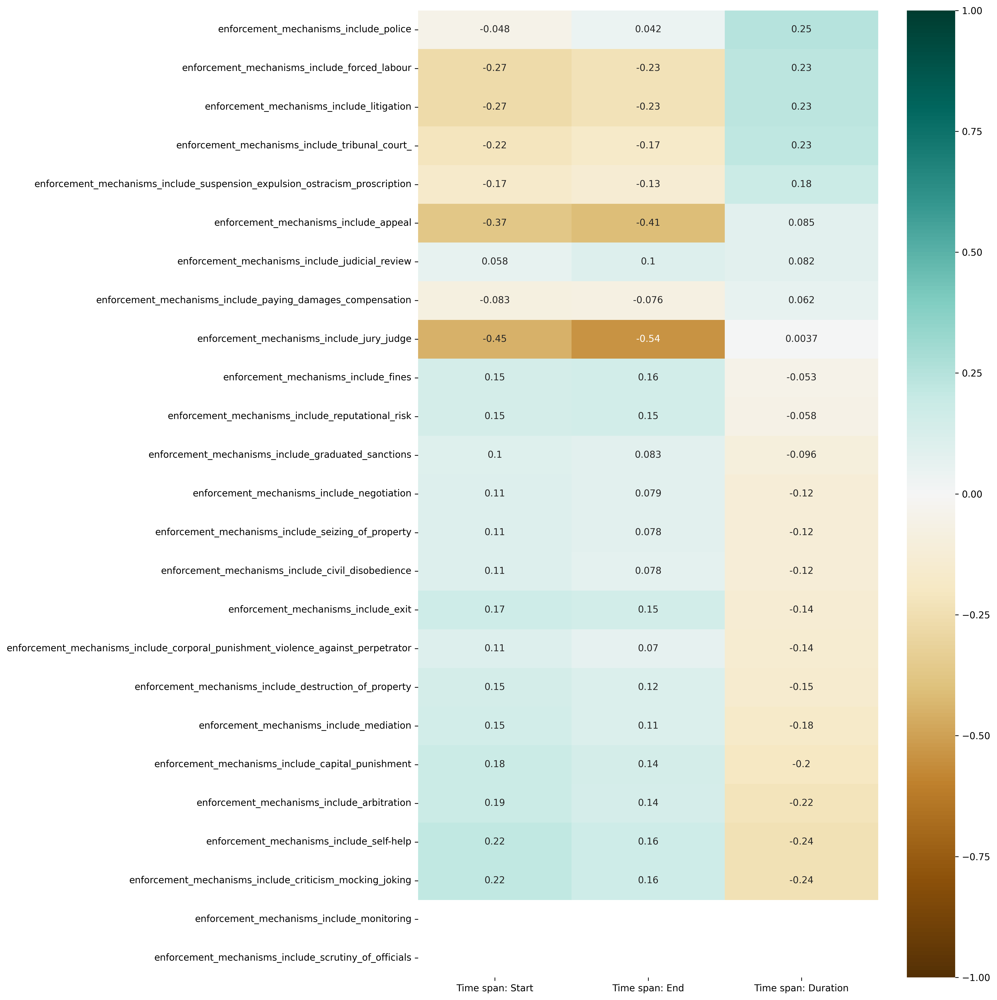

In [56]:
plt.figure(figsize=(15, 15))

sns.heatmap(time_enforcement_mechanisms.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations-no-eu/time_enforcement_mechanisms.png')
plt.show()

# Region x Mechanism

In [57]:
region_cols = [r for r in list(gov_df) if 'Region: ' in r] 

In [58]:
region_cols

['Region: Africa',
 'Region: Europe',
 'Region: Asia',
 'Region: Middle East',
 'Region: North America',
 'Region: Central America',
 'Region: South America',
 'Region: Oceania']

In [59]:
region_mechanisms = query_mechanisms_df[region_cols]
region_mechanisms

,Region: Africa,Region: Europe,Region: Asia,Region: Middle East,Region: North America,Region: Central America,Region: South America,Region: Oceania
access_mechanisms_include_age_boundaries,0.142110,NaN,-0.143058,-0.077326,-0.102133,-0.067962,-0.033120,-0.033120
access_mechanisms_include_blood_relations,0.654220,NaN,0.089834,-0.160217,-0.008790,-0.006426,0.089025,-0.068623
access_mechanisms_include_co-optation,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
access_mechanisms_include_divine_right,-0.032753,NaN,-0.176530,0.079494,0.121883,-0.083863,-0.040869,-0.040869
access_mechanisms_include_dreaming,-0.100365,NaN,0.078744,-0.096230,0.106069,-0.084576,-0.041216,-0.041216
access_mechanisms_include_election,0.710138,NaN,-0.025896,-0.141890,0.024882,-0.058612,-0.060774,-0.060774
access_mechanisms_include_enfranchisement,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
access_mechanisms_include_female_participation,0.101401,NaN,-0.247519,-0.239157,0.309666,-0.210194,-0.102434,0.200383
access_mechanisms_include_gerontocracy,-0.106381,NaN,0.017503,-0.110183,0.299050,-0.209538,-0.102114,-0.102114
access_mechanisms_include_heredity,-0.097287,NaN,0.136631,-0.124873,0.142158,0.103046,-0.127032,-0.127032


In [60]:
# Move Region: Europe to first col 
cols_to_move = ['Region: Europe']
region_mechanisms = region_mechanisms[cols_to_move + [col for col in region_mechanisms.columns if col not in cols_to_move]]

In [ ]:
plt.figure(figsize=(40, 30))

sns.heatmap(region_mechanisms.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations-no-eu/region_mechanisms.png')
plt.show()

### Region x Mechanism: Access, Decision Making, Enforcement

In [ ]:
region_access_mechanisms = region_mechanisms.loc[access_mechanisms]

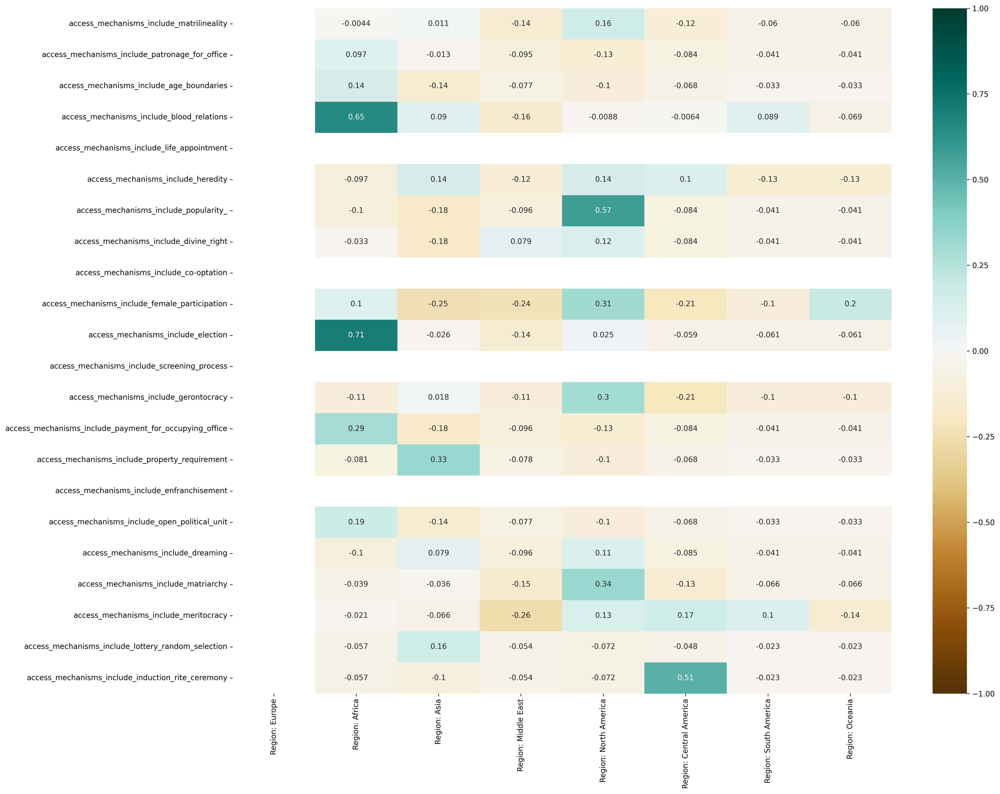

In [63]:
plt.figure(figsize=(20, 15))

sns.heatmap(region_access_mechanisms.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations-no-eu/region_access_mechanisms.png')
plt.show()

In [64]:
region_decision_making_mechanisms = region_mechanisms.loc[decision_making_mechanisms]

In [ ]:
plt.figure(figsize=(40, 30))

sns.heatmap(region_decision_making_mechanisms.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations-no-eu/region_decision_making_mechanisms.png')
plt.show()

In [66]:
region_enforcement_mechanisms = region_mechanisms.loc[enforcement_mechanisms]

In [ ]:
plt.figure(figsize=(20, 15))

sns.heatmap(region_enforcement_mechanisms.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations-no-eu/region_enforcement_mechanisms.png')
plt.show()

# Size x Mechanism

In [68]:
size_cols = [
    'Size: 100 - 1,000',
    'Size: 1,001 - 10,000',
    'Size: 10,001 - 100,000',
    'Size: 100,001 - 1,000,000',
    'Size: 1,000,001 - 10,000,000',
    'Size: 10,000,000+',
    'Size: Unknown'
]

In [69]:
size_mechanisms = query_mechanisms_df[size_cols]

In [ ]:
plt.figure(figsize=(40, 30))

sns.heatmap(size_mechanisms,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations-no-eu/size_mechanisms.png')
plt.show()

### Size x Mechanism: Access, Decision Making, Enforcement

In [ ]:
size_access_mechanisms = size_mechanisms.loc[access_mechanisms]

In [ ]:
plt.figure(figsize=(20, 15))

sns.heatmap(size_access_mechanisms,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations-no-eu/size_access_mechanisms.png')
plt.show()

In [73]:
size_decision_making_mechanisms = size_mechanisms.loc[decision_making_mechanisms]

In [ ]:
plt.figure(figsize=(20, 15))

sns.heatmap(size_decision_making_mechanisms,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations-no-eu/size_decision_making_mechanisms.png')
plt.show()

In [75]:
size_enforcement_mechanisms = size_mechanisms.loc[enforcement_mechanisms]

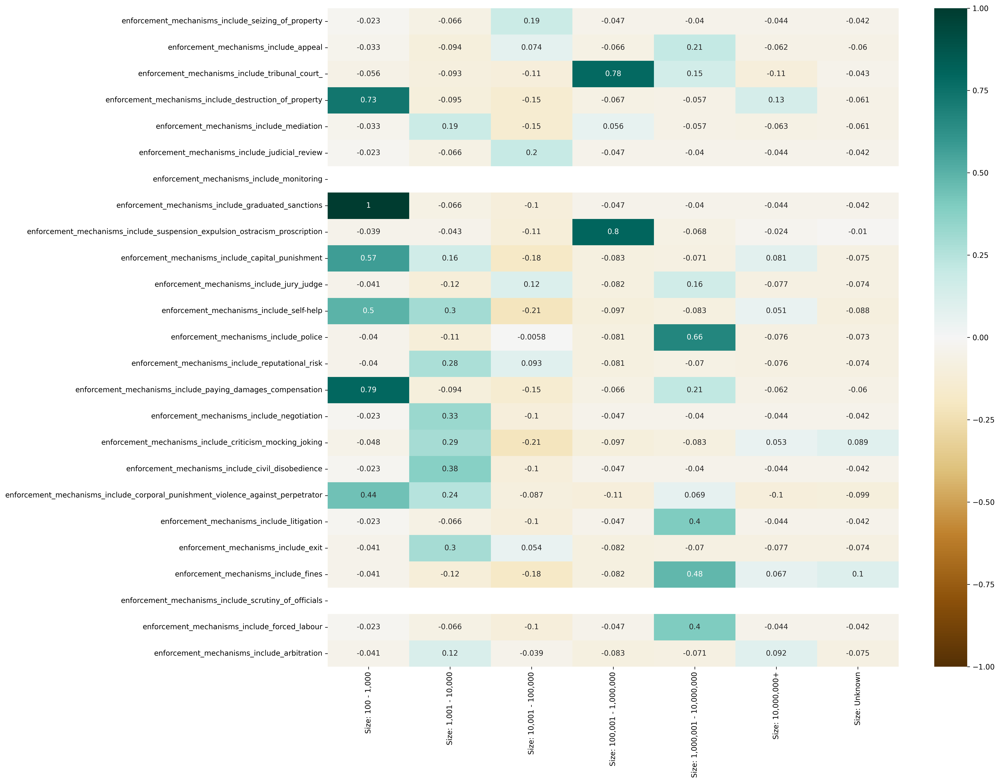

In [76]:
plt.figure(figsize=(20, 15))

sns.heatmap(size_enforcement_mechanisms,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations-no-eu/size_enforcement_mechanisms.png')
plt.show()

# Query and sort for mechanisms

In [77]:
def query_mech(col_name, ascending=False):
    # Return a sorted frame for a single column
    return query_mechanisms_df[col_name].sort_values(ascending=ascending)

In [78]:
query_mechanisms_df['Time span: Start'].sort_values(ascending=False)

access_mechanisms_include_female_participation                                     0.309083
decision_making_mechanisms_include_council_local                                   0.256527
access_mechanisms_include_matriarchy                                               0.251230
access_mechanisms_include_matrilineality                                           0.244255
enforcement_mechanisms_include_criticism_mocking_joking                            0.215684
enforcement_mechanisms_include_self-help                                           0.215431
decision_making_mechanisms_include_dual-sex_political_system                       0.191263
decision_making_mechanisms_include_constitution                                    0.190122
enforcement_mechanisms_include_arbitration                                         0.187123
decision_making_mechanisms_include_frequent_and_or_regular_meetings                0.184155
enforcement_mechanisms_include_capital_punishment                               

In [79]:
query_mech('Time span: Duration')

decision_making_mechanisms_include_assembly_central                                0.431058
decision_making_mechanisms_include_consultation                                    0.408284
access_mechanisms_include_property_requirement                                     0.353046
decision_making_mechanisms_include_council_central_                                0.340035
access_mechanisms_include_blood_relations                                          0.295465
decision_making_mechanisms_include_alliance                                        0.283082
decision_making_mechanisms_include_board_committee                                 0.280435
decision_making_mechanisms_include_magistrate_official                             0.262431
decision_making_mechanisms_include_autocratic_leader_chief_bound                   0.258848
enforcement_mechanisms_include_police                                              0.249350
decision_making_mechanisms_include_consensus                                    

In [80]:
query_mech('Time span: Duration', ascending=True)

enforcement_mechanisms_include_criticism_mocking_joking                           -0.240693
enforcement_mechanisms_include_self-help                                          -0.239927
enforcement_mechanisms_include_arbitration                                        -0.219398
decision_making_mechanisms_include_council_local                                  -0.212037
enforcement_mechanisms_include_capital_punishment                                 -0.202071
access_mechanisms_include_matrilineality                                          -0.201178
access_mechanisms_include_dreaming                                                -0.199722
enforcement_mechanisms_include_mediation                                          -0.178437
access_mechanisms_include_female_participation                                    -0.158142
decision_making_mechanisms_include_frequent_and_or_regular_meetings               -0.156536
enforcement_mechanisms_include_destruction_of_property                          

In [82]:
plt.figure(figsize=(60, 60))

# define the mask to set the values in the upper triangle to True
mask = np.triu(np.ones_like(norm_corr, dtype=np.bool))

triangle_heatmap = sns.heatmap(
    norm_corr, 
    mask=mask, 
    vmin=-1, 
    vmax=1, 
    annot=False, 
    cmap='BrBG', 
    xticklabels=1, 
    yticklabels=1)

triangle_heatmap.set_title('Correlations: Community Mechanisms', fontdict={'fontsize':18}, pad=16);

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations-no-eu/mechanisms_triangle_correlations.png')
plt.show()

/var/folders/v7/8x_7ty4j3m76hgg7tncks_kc0000gn/T/ipykernel_47933/4086532423.py:4: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = np.triu(np.ones_like(norm_corr, dtype=np.bool))


In [ ]:
plt.figure(figsize=(20,50))

heatmap = sns.heatmap(
    norm_corr[['Time span: Duration']].dropna().sort_values(
        by='Time span: Duration', 
        ascending=False), 
    vmin=-1, 
    vmax=1, 
    annot=True, 
    annot_kws={"size": 8},
    xticklabels=1, 
    yticklabels=1, 
    cmap='BrBG')

heatmap.set_title('Features Correlating with Time span: Duration', fontdict={'fontsize':18}, pad=16);

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations-no-eu/duration_correlations.png')
plt.show()

# Time x Region x Size

In [84]:
norm_corr[time_span_cols + region_cols + size_cols]

,Time span: Start,Time span: End,Time span: Duration,Region: Africa,Region: Europe,Region: Asia,Region: Middle East,Region: North America,Region: Central America,Region: South America,Region: Oceania,"Size: 100 - 1,000","Size: 1,001 - 10,000","Size: 10,001 - 100,000","Size: 100,001 - 1,000,000","Size: 1,000,001 - 10,000,000","Size: 10,000,000+",Size: Unknown
Time span: Start,1.000000,0.952073,-0.650546,-0.169085,NaN,-0.156077,-0.469168,0.297609,0.150353,0.106218,0.105955,0.100349,0.294579,0.014800,-0.231361,-0.017785,-0.114867,0.045065
Time span: End,0.952073,1.000000,-0.387067,-0.079087,NaN,-0.120741,-0.447721,0.259188,0.198418,0.077521,0.077793,0.083100,0.228537,-0.033790,-0.140512,0.021047,-0.072292,0.137330
enforcement_mechanisms_include_seizing_of_property,0.105330,0.078431,-0.122776,-0.056629,NaN,-0.100451,-0.054296,0.337367,-0.047721,-0.023256,-0.023256,-0.023256,-0.066255,0.186307,-0.046765,-0.040138,-0.043876,-0.042407
decision_making_mechanisms_include_public_meetings,-0.093999,-0.077317,0.091385,-0.116613,NaN,0.392552,-0.111808,0.090011,0.020054,-0.047889,-0.047889,0.277455,-0.000236,-0.212472,-0.045840,-0.082653,0.681061,-0.087326
decision_making_mechanisms_include_power_fluidity,0.106218,0.077521,-0.127713,-0.056629,NaN,-0.100451,-0.054296,-0.071715,-0.047721,1.000000,-0.023256,-0.023256,0.330592,-0.103180,-0.046765,-0.040138,-0.043876,-0.042407
decision_making_mechanisms_include_petition,-0.266643,-0.232256,0.227112,0.083561,NaN,-0.100451,-0.054296,-0.071715,-0.047721,-0.023256,-0.023256,-0.023256,-0.066255,-0.103180,-0.046765,0.399207,-0.043876,-0.042407
decision_making_mechanisms_include_veto,0.104955,0.078809,-0.120708,-0.056629,NaN,-0.100451,-0.054296,0.363680,-0.047721,-0.023256,-0.023256,-0.023256,-0.066255,0.204927,-0.046765,-0.040138,-0.043876,-0.042407
decision_making_mechanisms_include_representation,-0.013763,0.075020,0.227761,0.044977,NaN,0.252771,-0.224362,-0.055147,-0.197191,-0.096097,-0.096097,-0.096097,-0.154834,-0.037819,-0.193240,0.363031,0.032083,0.005807
decision_making_mechanisms_include_rule_of_law,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
enforcement_mechanisms_include_appeal,-0.367666,-0.412239,0.084759,0.004622,NaN,-0.142172,0.145234,-0.101500,-0.067541,-0.032915,-0.032915,-0.032915,-0.093773,0.073822,-0.066188,0.208857,-0.062099,-0.060021


In [85]:
time_region_size = norm_corr[time_span_cols + region_cols + size_cols].loc[time_span_cols + region_cols + size_cols]

In [86]:
time_region_size

,Time span: Start,Time span: End,Time span: Duration,Region: Africa,Region: Europe,Region: Asia,Region: Middle East,Region: North America,Region: Central America,Region: South America,Region: Oceania,"Size: 100 - 1,000","Size: 1,001 - 10,000","Size: 10,001 - 100,000","Size: 100,001 - 1,000,000","Size: 1,000,001 - 10,000,000","Size: 10,000,000+",Size: Unknown
Time span: Start,1.000000,0.952073,-0.650546,-0.169085,NaN,-0.156077,-0.469168,0.297609,0.150353,0.106218,0.105955,0.100349,0.294579,0.014800,-0.231361,-0.017785,-0.114867,0.045065
Time span: End,0.952073,1.000000,-0.387067,-0.079087,NaN,-0.120741,-0.447721,0.259188,0.198418,0.077521,0.077793,0.083100,0.228537,-0.033790,-0.140512,0.021047,-0.072292,0.137330
Time span: Duration,-0.650546,-0.387067,1.000000,0.313336,NaN,0.170700,0.302636,-0.253590,0.039423,-0.127713,-0.126245,-0.096168,-0.320560,-0.128514,0.348553,0.105870,0.166770,0.205134
Region: Africa,-0.169085,-0.079087,0.313336,1.000000,NaN,-0.244605,-0.132215,-0.174630,-0.116203,-0.056629,-0.056629,-0.056629,-0.030454,0.006291,0.719255,0.145359,-0.106840,-0.103264
Region: Europe,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Region: Asia,-0.156077,-0.120741,0.170700,-0.244605,NaN,1.000000,-0.234527,-0.309764,-0.206125,-0.100451,-0.100451,-0.100451,-0.286180,-0.180723,-0.201995,-0.043391,0.651827,0.040359
Region: Middle East,-0.469168,-0.447721,0.302636,-0.132215,NaN,-0.234527,1.000000,-0.167435,-0.111415,-0.054296,-0.054296,-0.054296,-0.154687,0.231033,-0.031313,-0.093712,-0.102438,0.496847
Region: North America,0.297609,0.259188,-0.253590,-0.174630,NaN,-0.309764,-0.167435,1.000000,-0.147158,-0.071715,-0.071715,0.302067,0.431783,0.056566,-0.144209,-0.123775,-0.135301,-0.130772
Region: Central America,0.150353,0.198418,0.039423,-0.116203,NaN,-0.206125,-0.111415,-0.147158,1.000000,-0.047721,-0.047721,-0.047721,-0.135954,-0.211725,0.372259,-0.082363,-0.090032,-0.087019
Region: South America,0.106218,0.077521,-0.127713,-0.056629,NaN,-0.100451,-0.054296,-0.071715,-0.047721,1.000000,-0.023256,-0.023256,0.330592,-0.103180,-0.046765,-0.040138,-0.043876,-0.042407


/var/folders/v7/8x_7ty4j3m76hgg7tncks_kc0000gn/T/ipykernel_47933/3617044581.py:4: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = np.triu(np.ones_like(time_region_size, dtype=np.bool))


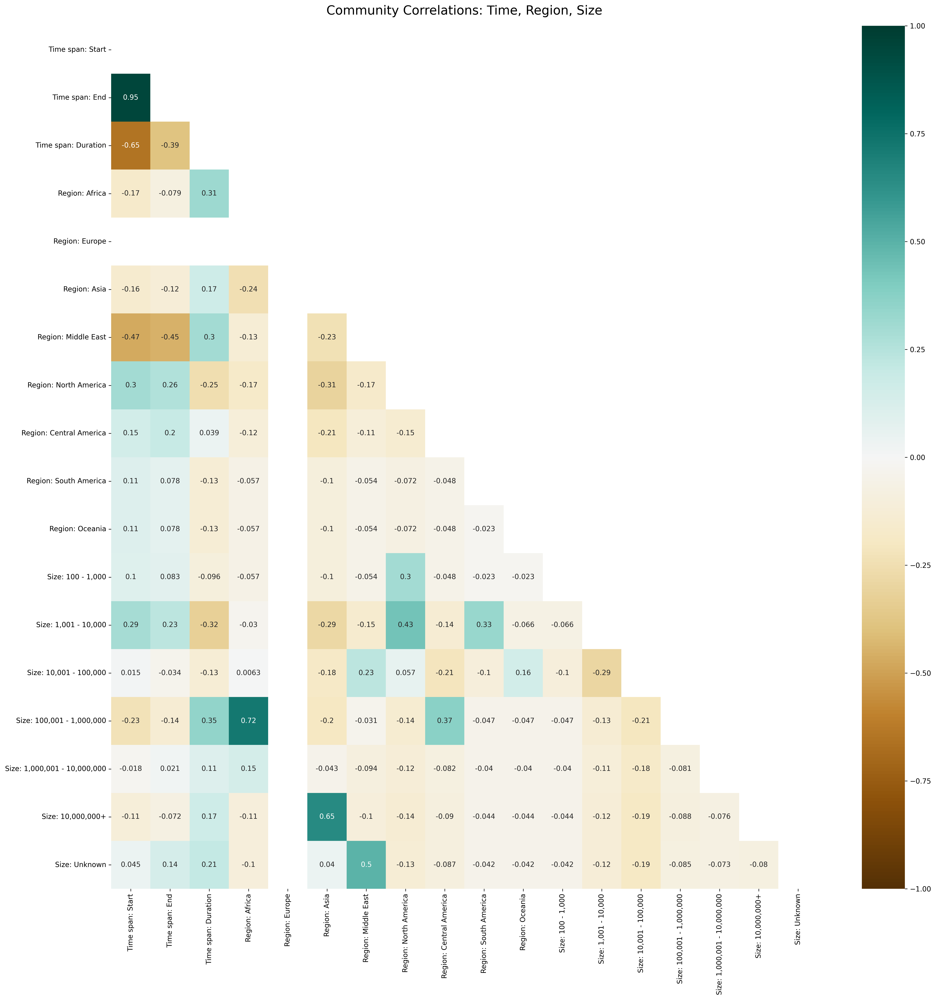

In [89]:
plt.figure(figsize=(20, 20))

# define the mask to set the values in the upper triangle to True
mask = np.triu(np.ones_like(time_region_size, dtype=np.bool))

triangle_heatmap = sns.heatmap(
    time_region_size, 
    mask=mask, 
    vmin=-1, 
    vmax=1, 
    annot=True, 
    cmap='BrBG', 
    xticklabels=1, 
    yticklabels=1)

triangle_heatmap.set_title('Community Correlations: Time, Region, Size', fontdict={'fontsize':18}, pad=16);

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations-no-eu/communities_time_region_size.png')
plt.show()

## Time

In [90]:
time_corr = norm_corr[time_span_cols].loc[region_cols + size_cols]

In [91]:
time_corr

,Time span: Start,Time span: End,Time span: Duration
Region: Africa,-0.169085,-0.079087,0.313336
Region: Europe,NaN,NaN,NaN
Region: Asia,-0.156077,-0.120741,0.170700
Region: Middle East,-0.469168,-0.447721,0.302636
Region: North America,0.297609,0.259188,-0.253590
Region: Central America,0.150353,0.198418,0.039423
Region: South America,0.106218,0.077521,-0.127713
Region: Oceania,0.105955,0.077793,-0.126245
"Size: 100 - 1,000",0.100349,0.083100,-0.096168
"Size: 1,001 - 10,000",0.294579,0.228537,-0.320560


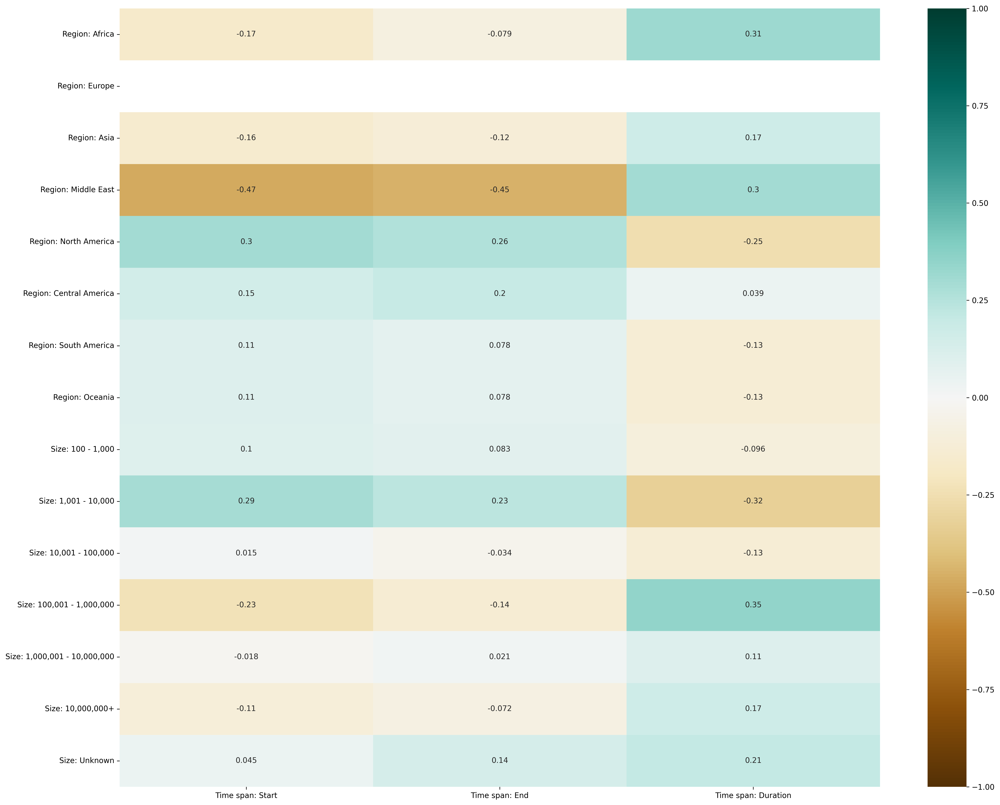

In [94]:
plt.figure(figsize=(20, 15))

sns.heatmap(time_corr,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations-no-eu/communities_time_correlations.png')
plt.show()

## Region

In [95]:
region_corr = norm_corr[region_cols].loc[time_span_cols + size_cols]

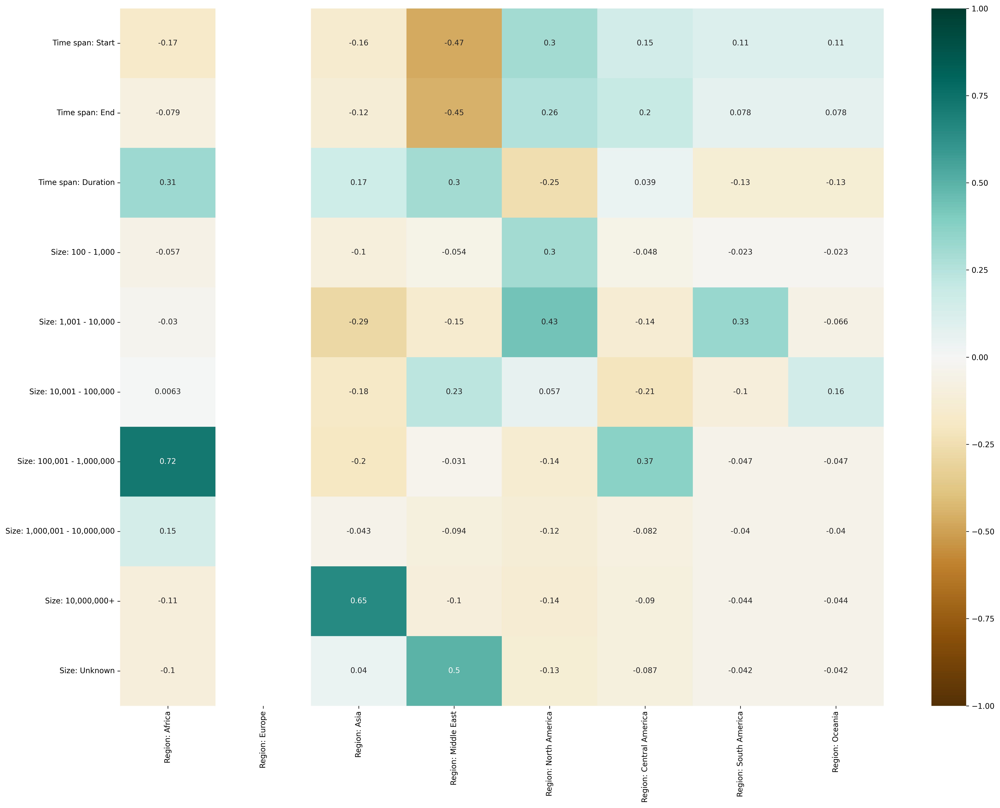

In [96]:
plt.figure(figsize=(20, 15))

sns.heatmap(region_corr,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations-no-eu/communities_region_correlations.png')
plt.show()

## Size 

In [97]:
size_corr = norm_corr[size_cols].loc[time_span_cols + region_cols]

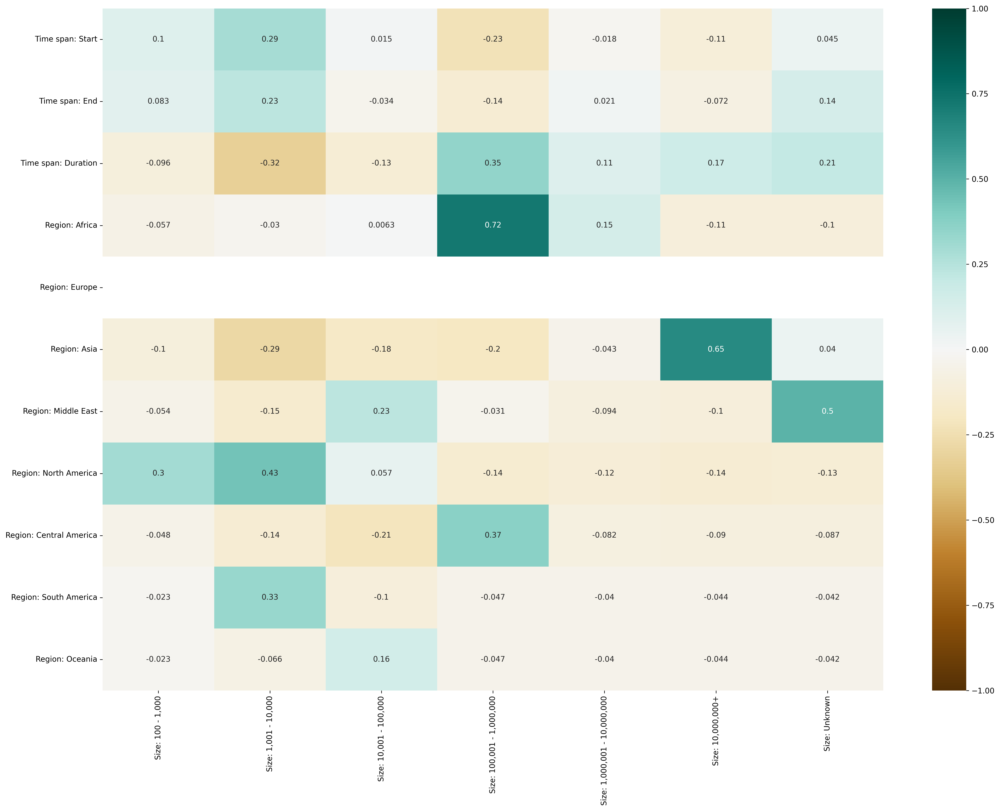

In [98]:
plt.figure(figsize=(20, 15))

sns.heatmap(size_corr,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations-no-eu/communities_size_correlations.png')
plt.show()